### Install `diffusers`

In [1]:
%%capture
!pip install diffusers==0.11.1

In [2]:
import tqdm
import torch
import PIL.Image
import numpy as np

from diffusers import UNet2DModel


### Load model and Scheduler

In [3]:
#repo_id = "google/ddpm-church-256"
repo_id="google/ddpm-celebahq-256"

model = UNet2DModel.from_pretrained(repo_id)
model.to("cuda")


Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


UNet2DModel(
  (conv_in): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=128, out_features=512, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=512, out_features=512, bias=True)
  )
  (down_blocks): ModuleList(
    (0-1): 2 x DownBlock2D(
      (resnets): ModuleList(
        (0-1): 2 x ResnetBlock2D(
          (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
          (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (time_emb_proj): Linear(in_features=512, out_features=128, bias=True)
          (norm2): GroupNorm(32, 128, eps=1e-06, affine=True)
          (dropout): Dropout(p=0.0, inplace=False)
          (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (nonlinearity): SiLU()
        )
      )
      (downsamplers): ModuleList(
        (0): Downsample2D(
          (conv): Con

Now let's take a look at the model's configuration. The configuration can be accessed via the `config` attribute and shows all the necessary parameters to define the model architecture (and only those).

In [4]:
model.config

FrozenDict([('sample_size', 256),
            ('in_channels', 3),
            ('out_channels', 3),
            ('center_input_sample', False),
            ('time_embedding_type', 'positional'),
            ('freq_shift', 1),
            ('flip_sin_to_cos', False),
            ('down_block_types',
             ['DownBlock2D',
              'DownBlock2D',
              'DownBlock2D',
              'DownBlock2D',
              'AttnDownBlock2D',
              'DownBlock2D']),
            ('up_block_types',
             ['UpBlock2D',
              'AttnUpBlock2D',
              'UpBlock2D',
              'UpBlock2D',
              'UpBlock2D',
              'UpBlock2D']),
            ('block_out_channels', [128, 128, 256, 256, 512, 512]),
            ('layers_per_block', 2),
            ('mid_block_scale_factor', 1),
            ('downsample_padding', 0),
            ('act_fn', 'silu'),
            ('attention_head_dim', None),
            ('norm_num_groups', 32),
            ('norm_eps', 


A couple of important config parameters are:
- `sample_size`: defines the `height` and `width` dimension of the input sample.
- `in_channels`: defines the number of input channels of the input sample.
- `down_block_types` and `up_block_types`: define the type of down- and upsampling blocks that are used to create the UNet architecture as was seen in the figure at the beginning of this notebook.
- `block_out_channels`: defines the number of output channels of the downsampling blocks, also used in reversed order for the number of input channels of the upsampling blocks.
- `layers_per_block`: defines how many ResNet blocks are present in each UNet block.

Knowing how a UNet config looks like, you can quickly try to instantiate the exact same model architecture with random weights. To do so, let's pass the config as an unpacked dict to the `UNet2DModel` class.

In [5]:

from diffusers import DDPMScheduler
scheduler_slow = DDPMScheduler.from_config(repo_id)
print(scheduler_slow.config)

# faster, maybe less good quality
from diffusers import DDIMScheduler
scheduler = DDIMScheduler.from_config(repo_id)
scheduler.set_timesteps(num_inference_steps=50)
print(scheduler.config)

FrozenDict([('num_train_timesteps', 1000), ('beta_start', 0.0001), ('beta_end', 0.02), ('beta_schedule', 'linear'), ('trained_betas', None), ('variance_type', 'fixed_small'), ('clip_sample', True), ('prediction_type', 'epsilon'), ('_class_name', 'DDPMScheduler'), ('_diffusers_version', '0.1.1')])
FrozenDict([('num_train_timesteps', 1000), ('beta_start', 0.0001), ('beta_end', 0.02), ('beta_schedule', 'linear'), ('trained_betas', None), ('clip_sample', True), ('set_alpha_to_one', True), ('steps_offset', 0), ('prediction_type', 'epsilon'), ('_class_name', 'DDPMScheduler'), ('_diffusers_version', '0.1.1'), ('variance_type', 'fixed_small')])


Let's also take a look at the config here.

In [6]:

def display_sample(sample, i):
    image_processed = sample.cpu().permute(0, 2, 3, 1)
    image_processed = (image_processed + 1.0) * 127.5
    image_processed = image_processed.numpy().astype(np.uint8)

    image_pil = PIL.Image.fromarray(image_processed[0])
    display(f"Image at step {i}")
    display(image_pil)

In [7]:
def denoising_diffusion(noisy_sample):
  sample = noisy_sample

  for i, t in enumerate(tqdm.tqdm(scheduler.timesteps)):
    # 1. predict noise residual
    with torch.no_grad():
        residual = model(sample, t).sample

    # 2. compute less noisy image and set x_t -> x_t-1
    sample = scheduler.step(residual, t, sample).prev_sample
  
  display_sample(sample, scheduler.timesteps[0])
  return sample


In [8]:

torch.manual_seed(125)

noisy_sample1 = torch.randn(
    1, model.config.in_channels, model.config.sample_size, model.config.sample_size
)

print(noisy_sample1.shape)

noisy_sample1 = noisy_sample1.to("cuda")


torch.Size([1, 3, 256, 256])


torch.Size([1, 3, 256, 256])


100%|██████████| 50/50 [00:03<00:00, 14.17it/s]


'Image at step 980'

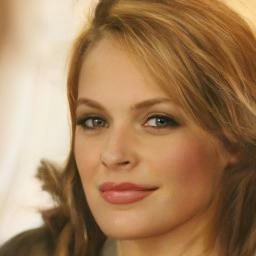

In [9]:
print(noisy_sample1.shape)
sample1=denoising_diffusion(noisy_sample1)

In [10]:
torch.manual_seed(127)

noisy_sample2 = torch.randn(
    1, model.config.in_channels, model.config.sample_size, model.config.sample_size
)


noisy_sample2 = noisy_sample2.to("cuda")


100%|██████████| 50/50 [00:01<00:00, 32.57it/s]


'Image at step 980'

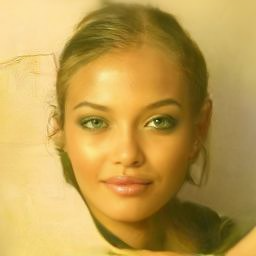

In [11]:
sample2=denoising_diffusion(noisy_sample2)

100%|██████████| 50/50 [00:01<00:00, 32.98it/s]


'Image at step 980'

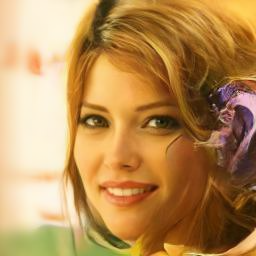

In [12]:
alpha=0.5
alpha_noisy_sample=(alpha*noisy_sample1+(1-alpha)*noisy_sample2)/(np.sqrt(alpha**2+(1-alpha)**2))
alpha_sample=denoising_diffusion(alpha_noisy_sample)


**Create an interpolation**

iter:0


100%|██████████| 50/50 [00:01<00:00, 32.81it/s]


'Image at step 980'

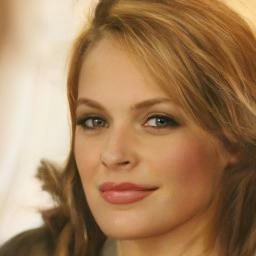

iter:1


100%|██████████| 50/50 [00:01<00:00, 33.82it/s]


'Image at step 980'

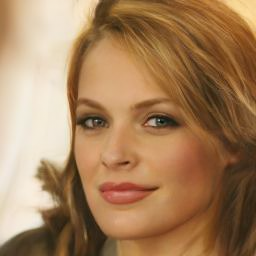

iter:2


100%|██████████| 50/50 [00:01<00:00, 33.70it/s]


'Image at step 980'

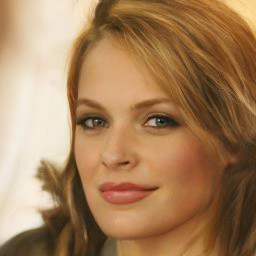

iter:3


100%|██████████| 50/50 [00:01<00:00, 34.10it/s]


'Image at step 980'

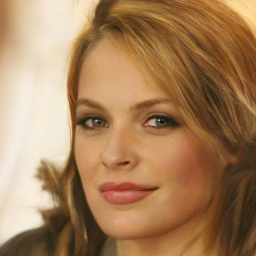

iter:4


100%|██████████| 50/50 [00:01<00:00, 33.57it/s]


'Image at step 980'

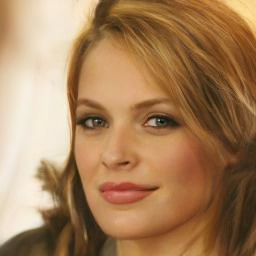

iter:5


100%|██████████| 50/50 [00:01<00:00, 34.01it/s]


'Image at step 980'

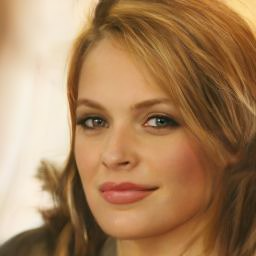

iter:6


100%|██████████| 50/50 [00:01<00:00, 33.28it/s]


'Image at step 980'

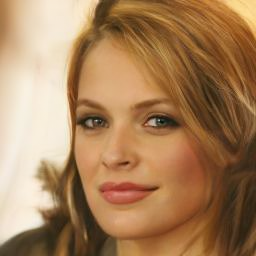

iter:7


100%|██████████| 50/50 [00:01<00:00, 33.30it/s]


'Image at step 980'

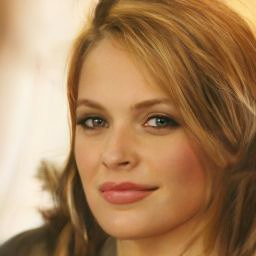

iter:8


100%|██████████| 50/50 [00:01<00:00, 33.60it/s]


'Image at step 980'

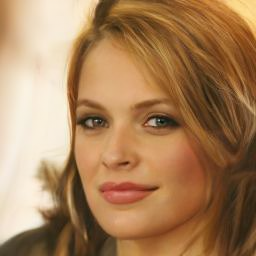

iter:9


100%|██████████| 50/50 [00:01<00:00, 33.79it/s]


'Image at step 980'

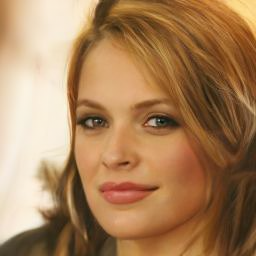

iter:10


100%|██████████| 50/50 [00:01<00:00, 33.52it/s]


'Image at step 980'

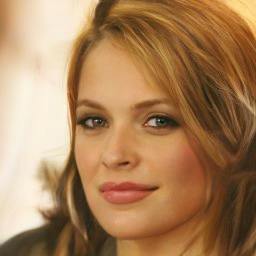

iter:11


100%|██████████| 50/50 [00:01<00:00, 34.10it/s]


'Image at step 980'

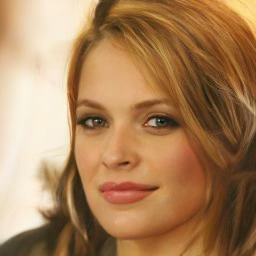

iter:12


100%|██████████| 50/50 [00:01<00:00, 33.79it/s]


'Image at step 980'

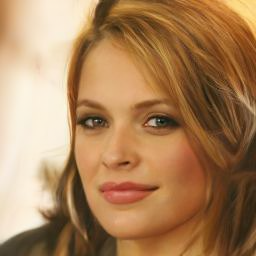

iter:13


100%|██████████| 50/50 [00:01<00:00, 34.18it/s]


'Image at step 980'

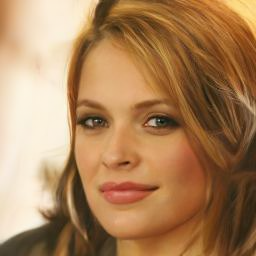

iter:14


100%|██████████| 50/50 [00:01<00:00, 33.58it/s]


'Image at step 980'

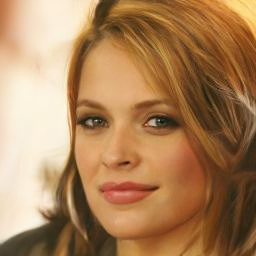

iter:15


100%|██████████| 50/50 [00:01<00:00, 33.43it/s]


'Image at step 980'

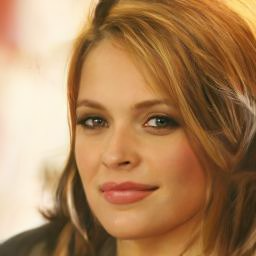

iter:16


100%|██████████| 50/50 [00:01<00:00, 33.67it/s]


'Image at step 980'

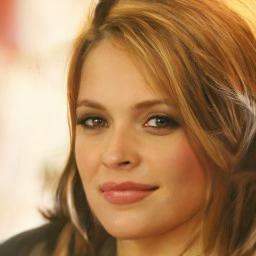

iter:17


100%|██████████| 50/50 [00:01<00:00, 33.67it/s]


'Image at step 980'

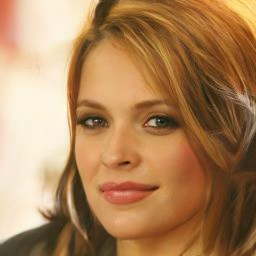

iter:18


100%|██████████| 50/50 [00:01<00:00, 33.41it/s]


'Image at step 980'

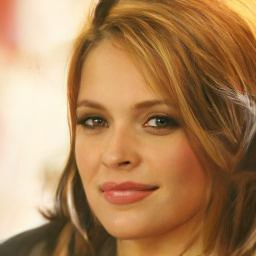

iter:19


100%|██████████| 50/50 [00:01<00:00, 33.26it/s]


'Image at step 980'

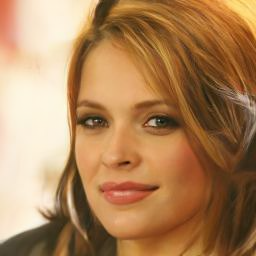

iter:20


100%|██████████| 50/50 [00:01<00:00, 33.69it/s]


'Image at step 980'

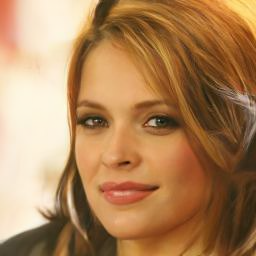

iter:21


100%|██████████| 50/50 [00:01<00:00, 33.46it/s]


'Image at step 980'

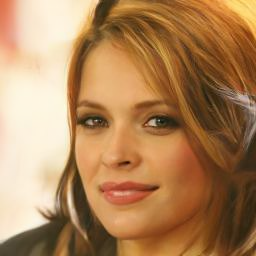

iter:22


100%|██████████| 50/50 [00:01<00:00, 33.60it/s]


'Image at step 980'

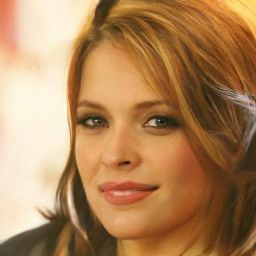

iter:23


100%|██████████| 50/50 [00:01<00:00, 33.91it/s]


'Image at step 980'

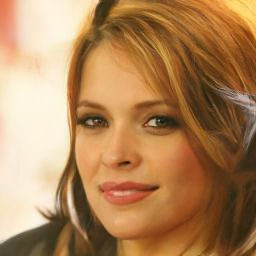

iter:24


100%|██████████| 50/50 [00:01<00:00, 33.66it/s]


'Image at step 980'

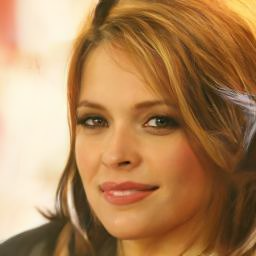

iter:25


100%|██████████| 50/50 [00:01<00:00, 34.12it/s]


'Image at step 980'

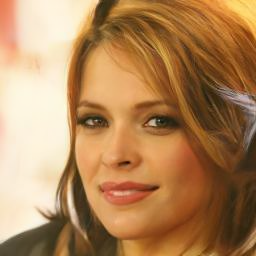

iter:26


100%|██████████| 50/50 [00:01<00:00, 33.99it/s]


'Image at step 980'

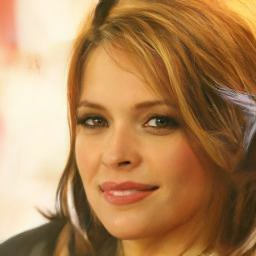

iter:27


100%|██████████| 50/50 [00:01<00:00, 33.66it/s]


'Image at step 980'

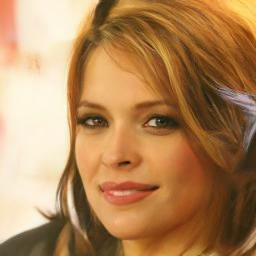

iter:28


100%|██████████| 50/50 [00:01<00:00, 33.90it/s]


'Image at step 980'

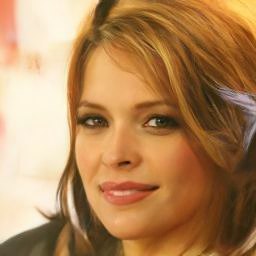

iter:29


100%|██████████| 50/50 [00:01<00:00, 33.70it/s]


'Image at step 980'

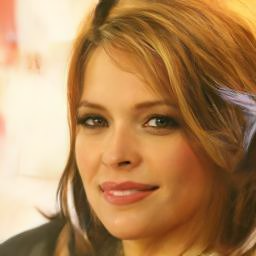

iter:30


100%|██████████| 50/50 [00:01<00:00, 32.65it/s]


'Image at step 980'

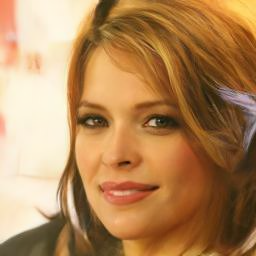

iter:31


100%|██████████| 50/50 [00:01<00:00, 33.63it/s]


'Image at step 980'

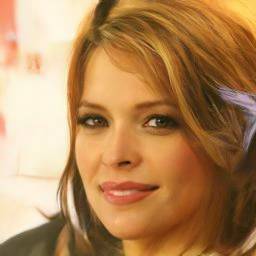

iter:32


100%|██████████| 50/50 [00:01<00:00, 33.34it/s]


'Image at step 980'

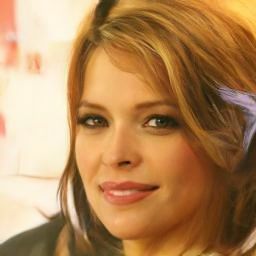

iter:33


100%|██████████| 50/50 [00:01<00:00, 33.61it/s]


'Image at step 980'

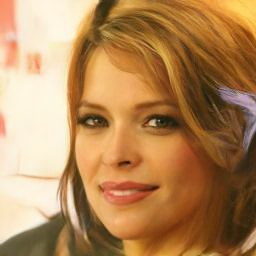

iter:34


100%|██████████| 50/50 [00:01<00:00, 33.36it/s]


'Image at step 980'

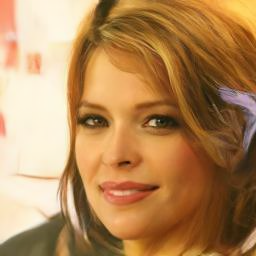

iter:35


100%|██████████| 50/50 [00:01<00:00, 33.29it/s]


'Image at step 980'

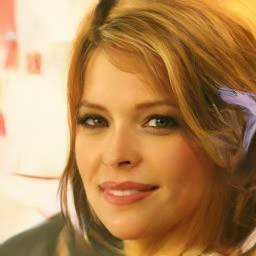

iter:36


100%|██████████| 50/50 [00:01<00:00, 33.26it/s]


'Image at step 980'

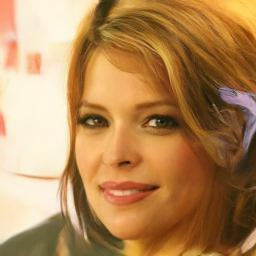

iter:37


100%|██████████| 50/50 [00:01<00:00, 33.53it/s]


'Image at step 980'

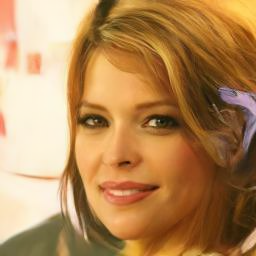

iter:38


100%|██████████| 50/50 [00:01<00:00, 33.77it/s]


'Image at step 980'

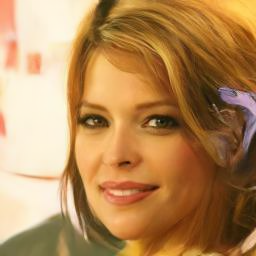

iter:39


100%|██████████| 50/50 [00:01<00:00, 33.79it/s]


'Image at step 980'

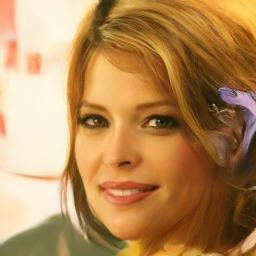

iter:40


100%|██████████| 50/50 [00:01<00:00, 33.05it/s]


'Image at step 980'

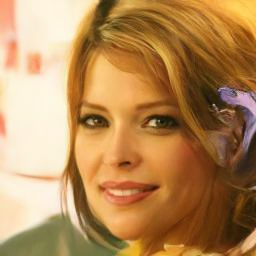

iter:41


100%|██████████| 50/50 [00:01<00:00, 33.99it/s]


'Image at step 980'

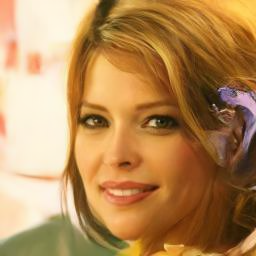

iter:42


100%|██████████| 50/50 [00:01<00:00, 34.00it/s]


'Image at step 980'

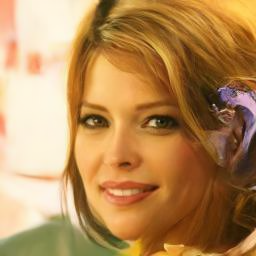

iter:43


100%|██████████| 50/50 [00:01<00:00, 33.47it/s]


'Image at step 980'

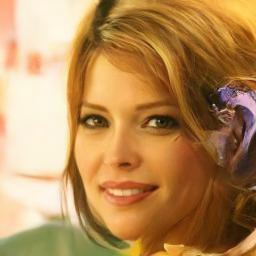

iter:44


100%|██████████| 50/50 [00:01<00:00, 32.77it/s]


'Image at step 980'

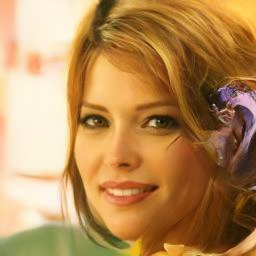

iter:45


100%|██████████| 50/50 [00:01<00:00, 33.72it/s]


'Image at step 980'

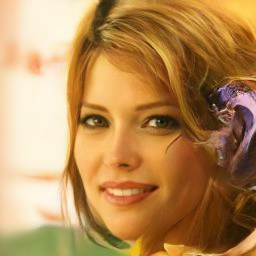

iter:46


100%|██████████| 50/50 [00:01<00:00, 33.89it/s]


'Image at step 980'

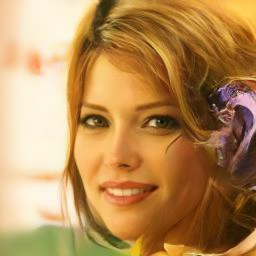

iter:47


100%|██████████| 50/50 [00:01<00:00, 33.26it/s]


'Image at step 980'

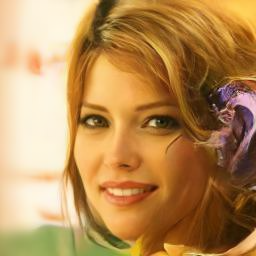

iter:48


100%|██████████| 50/50 [00:01<00:00, 33.71it/s]


'Image at step 980'

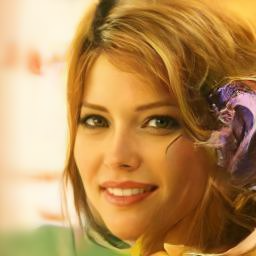

iter:49


100%|██████████| 50/50 [00:01<00:00, 33.55it/s]


'Image at step 980'

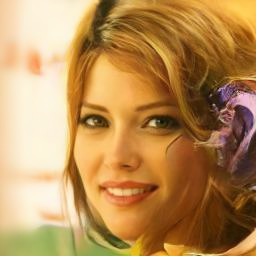

iter:50


100%|██████████| 50/50 [00:01<00:00, 33.27it/s]


'Image at step 980'

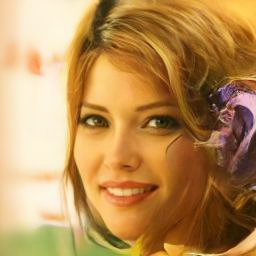

iter:51


100%|██████████| 50/50 [00:01<00:00, 33.08it/s]


'Image at step 980'

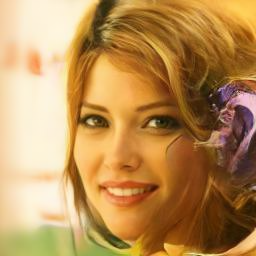

iter:52


100%|██████████| 50/50 [00:01<00:00, 33.39it/s]


'Image at step 980'

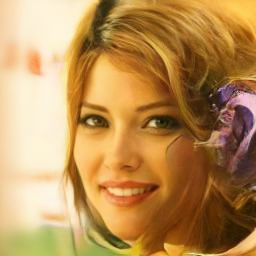

iter:53


100%|██████████| 50/50 [00:01<00:00, 33.72it/s]


'Image at step 980'

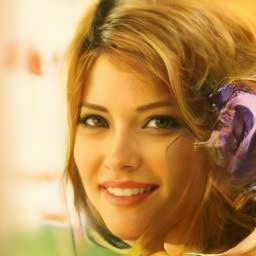

iter:54


100%|██████████| 50/50 [00:01<00:00, 33.56it/s]


'Image at step 980'

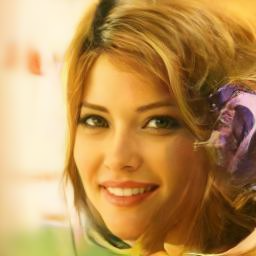

iter:55


100%|██████████| 50/50 [00:01<00:00, 33.76it/s]


'Image at step 980'

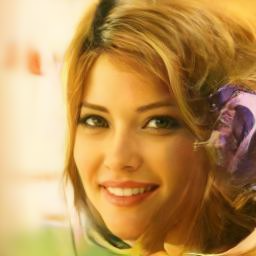

iter:56


100%|██████████| 50/50 [00:01<00:00, 33.41it/s]


'Image at step 980'

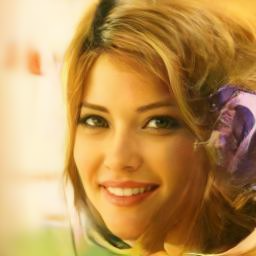

iter:57


100%|██████████| 50/50 [00:01<00:00, 32.88it/s]


'Image at step 980'

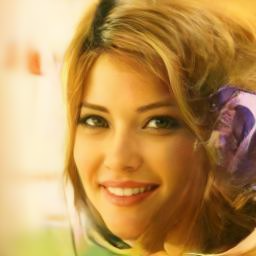

iter:58


100%|██████████| 50/50 [00:01<00:00, 32.54it/s]


'Image at step 980'

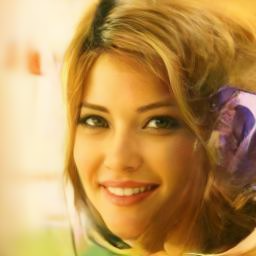

iter:59


100%|██████████| 50/50 [00:01<00:00, 32.90it/s]


'Image at step 980'

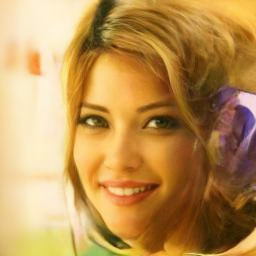

iter:60


100%|██████████| 50/50 [00:01<00:00, 33.53it/s]


'Image at step 980'

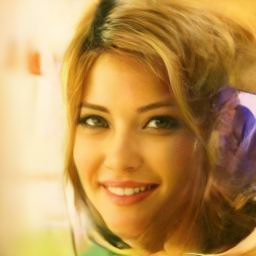

iter:61


100%|██████████| 50/50 [00:01<00:00, 33.56it/s]


'Image at step 980'

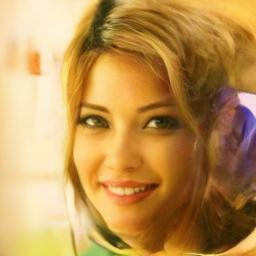

iter:62


100%|██████████| 50/50 [00:01<00:00, 33.54it/s]


'Image at step 980'

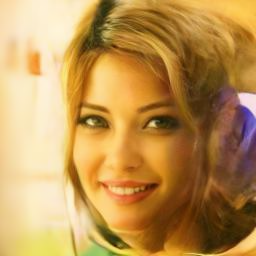

iter:63


100%|██████████| 50/50 [00:01<00:00, 34.14it/s]


'Image at step 980'

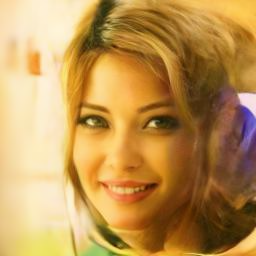

iter:64


100%|██████████| 50/50 [00:01<00:00, 33.91it/s]


'Image at step 980'

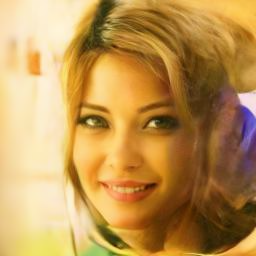

iter:65


100%|██████████| 50/50 [00:01<00:00, 32.83it/s]


'Image at step 980'

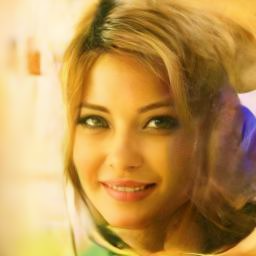

iter:66


100%|██████████| 50/50 [00:01<00:00, 34.01it/s]


'Image at step 980'

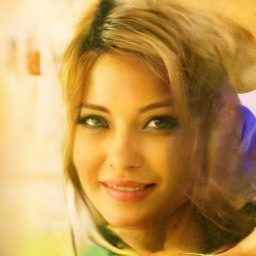

iter:67


100%|██████████| 50/50 [00:01<00:00, 33.21it/s]


'Image at step 980'

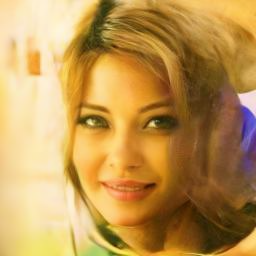

iter:68


100%|██████████| 50/50 [00:01<00:00, 33.34it/s]


'Image at step 980'

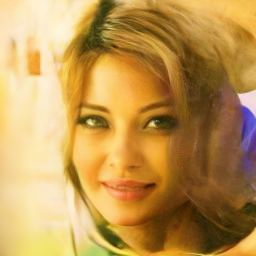

iter:69


100%|██████████| 50/50 [00:01<00:00, 33.82it/s]


'Image at step 980'

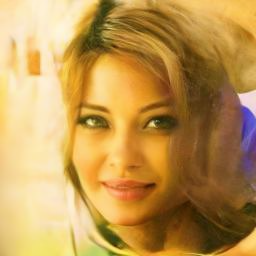

iter:70


100%|██████████| 50/50 [00:01<00:00, 33.30it/s]


'Image at step 980'

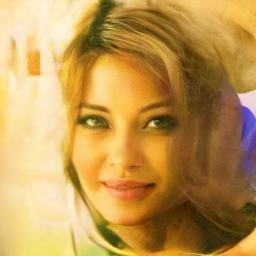

iter:71


100%|██████████| 50/50 [00:01<00:00, 33.16it/s]


'Image at step 980'

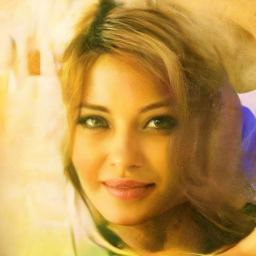

iter:72


100%|██████████| 50/50 [00:01<00:00, 32.84it/s]


'Image at step 980'

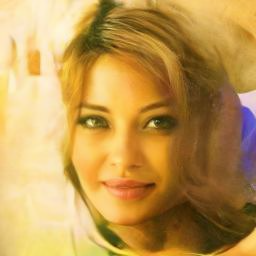

iter:73


100%|██████████| 50/50 [00:01<00:00, 32.96it/s]


'Image at step 980'

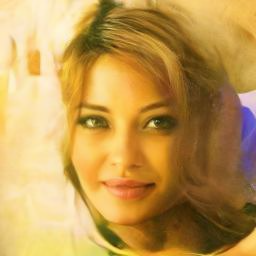

iter:74


100%|██████████| 50/50 [00:01<00:00, 33.35it/s]


'Image at step 980'

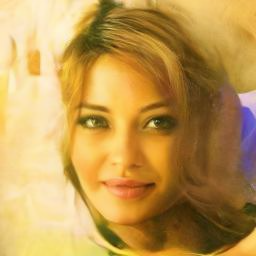

iter:75


100%|██████████| 50/50 [00:01<00:00, 33.83it/s]


'Image at step 980'

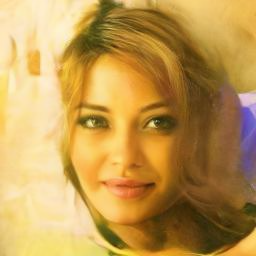

iter:76


100%|██████████| 50/50 [00:01<00:00, 33.53it/s]


'Image at step 980'

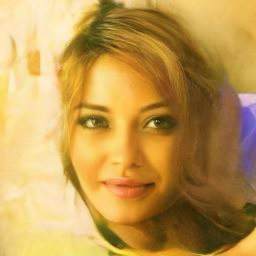

iter:77


100%|██████████| 50/50 [00:01<00:00, 32.95it/s]


'Image at step 980'

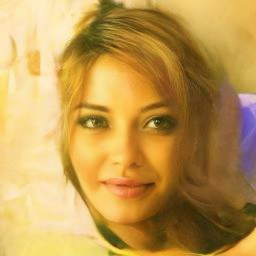

iter:78


100%|██████████| 50/50 [00:01<00:00, 33.27it/s]


'Image at step 980'

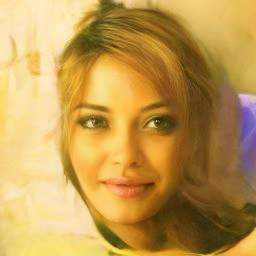

iter:79


100%|██████████| 50/50 [00:01<00:00, 33.78it/s]


'Image at step 980'

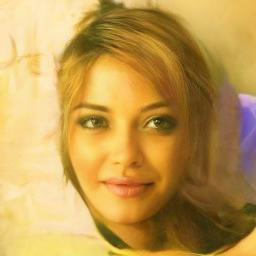

iter:80


100%|██████████| 50/50 [00:01<00:00, 33.28it/s]


'Image at step 980'

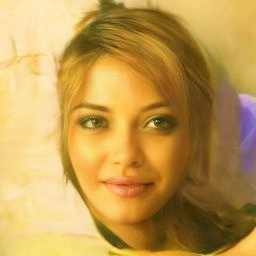

iter:81


100%|██████████| 50/50 [00:01<00:00, 33.42it/s]


'Image at step 980'

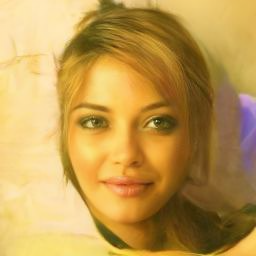

iter:82


100%|██████████| 50/50 [00:01<00:00, 33.06it/s]


'Image at step 980'

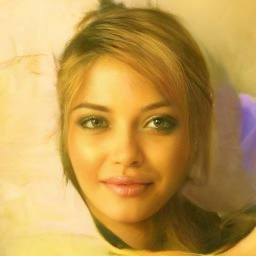

iter:83


100%|██████████| 50/50 [00:01<00:00, 33.01it/s]


'Image at step 980'

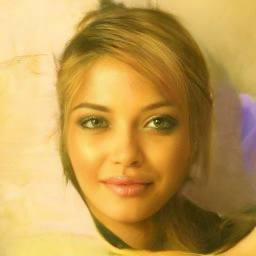

iter:84


100%|██████████| 50/50 [00:01<00:00, 32.29it/s]


'Image at step 980'

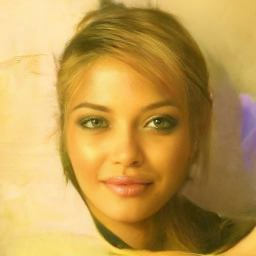

iter:85


100%|██████████| 50/50 [00:01<00:00, 32.85it/s]


'Image at step 980'

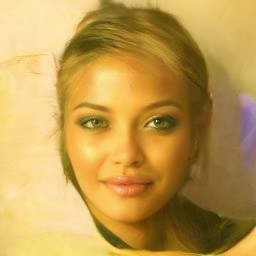

iter:86


100%|██████████| 50/50 [00:01<00:00, 33.30it/s]


'Image at step 980'

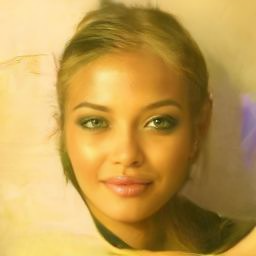

iter:87


100%|██████████| 50/50 [00:01<00:00, 33.03it/s]


'Image at step 980'

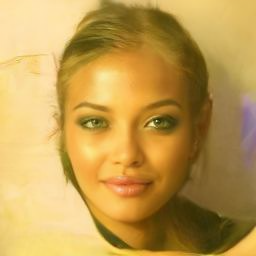

iter:88


100%|██████████| 50/50 [00:01<00:00, 33.33it/s]


'Image at step 980'

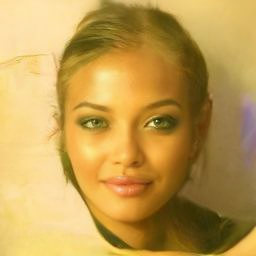

iter:89


100%|██████████| 50/50 [00:01<00:00, 33.27it/s]


'Image at step 980'

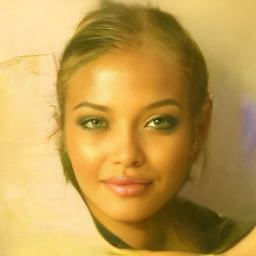

iter:90


100%|██████████| 50/50 [00:01<00:00, 33.45it/s]


'Image at step 980'

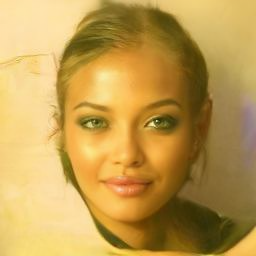

iter:91


100%|██████████| 50/50 [00:01<00:00, 33.30it/s]


'Image at step 980'

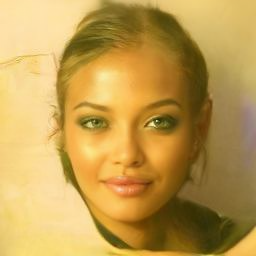

iter:92


100%|██████████| 50/50 [00:01<00:00, 33.63it/s]


'Image at step 980'

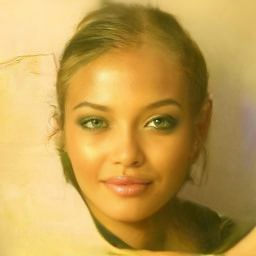

iter:93


100%|██████████| 50/50 [00:01<00:00, 32.99it/s]


'Image at step 980'

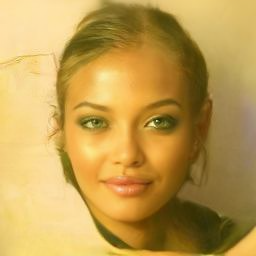

iter:94


100%|██████████| 50/50 [00:01<00:00, 33.69it/s]


'Image at step 980'

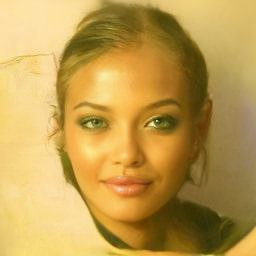

iter:95


100%|██████████| 50/50 [00:01<00:00, 33.31it/s]


'Image at step 980'

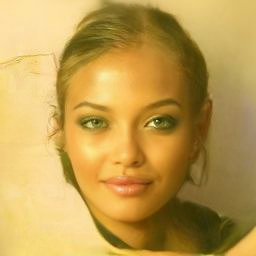

iter:96


100%|██████████| 50/50 [00:01<00:00, 34.03it/s]


'Image at step 980'

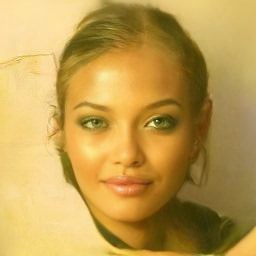

iter:97


100%|██████████| 50/50 [00:01<00:00, 33.33it/s]


'Image at step 980'

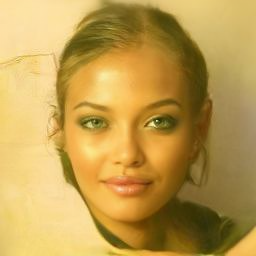

iter:98


100%|██████████| 50/50 [00:01<00:00, 33.49it/s]


'Image at step 980'

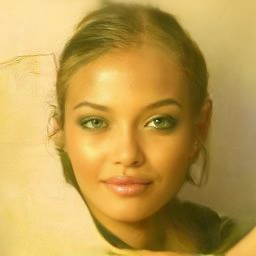

iter:99


100%|██████████| 50/50 [00:01<00:00, 33.00it/s]


'Image at step 980'

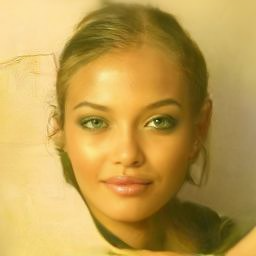

In [13]:
all_samples=[]
for iter, alpha in enumerate(np.linspace(0,1,100)):
  print(f'iter:{iter}')
  alpha_noisy_sample=((1-alpha)*noisy_sample1+alpha*noisy_sample2)/(np.sqrt(alpha**2+(1-alpha)**2))
  alpha_sample=denoising_diffusion(alpha_noisy_sample)
  all_samples.append(alpha_sample)

###Animation

In [14]:
def get_PIL_img(sample):
    image_processed = sample.cpu().permute(0, 2, 3, 1)
    image_processed = (image_processed + 1.0) * 127.5
    image_processed = image_processed.numpy().astype(np.uint8)

    image_pil = PIL.Image.fromarray(image_processed[0])
    #display(image_pil)
    return image_pil

pil_imgs=[get_PIL_img(it) for it in all_samples]

In [15]:
pil_imgs=pil_imgs+pil_imgs[::-1]
len(pil_imgs)

200

In [19]:
gif = []
for image in pil_imgs:
    gif.append(image.convert("P",palette=PIL.Image.ADAPTIVE))
gif[0].save('anim_results.gif', save_all=True,optimize=False, append_images=gif[1:], duration=120, loop=0)

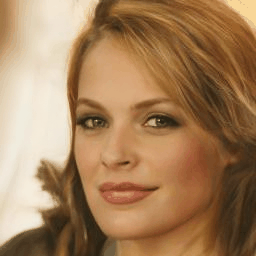

In [20]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from IPython import display

gifPath = "anim_results.gif" 
# Display GIF in Jupyter, CoLab, IPython
with open(gifPath,'rb') as f:
    display.Image(data=f.read(), format='png')